In [44]:
# Importando as bibliotecas necessárias
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [45]:
# Função para executar o método MVF juntamente com o algoritmo TDMA

def step_MVF(T, k, rho_cp, dx, dt, n):
    """
    Executa um passo de tempo da equação da difusão considerando
    escoamento unidimensional, RP e propriedades uniformes em cada seção.
    Foi utilizado a prática B, onde as intefaces dos VCs no domínio de cálculo 
    são definidas e, em seguida, os pontos nodais são localizados no 
    centro de cada VC, assim temos n+2 nós, onde n é o número de VCs
    """ 

    N = len(T) # Obtém o tamanho total do vetor de temperaturas

    # Coeficientes constantes dos nós centrais
    a = k / dx
    ap0 = rho_cp * dx / dt
    ap = 2 * a + ap0

    # Vetores TDMA
    A = np.zeros(N) # Diagonal principal (coeficiente de T[i])
    B = np.zeros(N) # Subdiagonal (coeficiente de T[i-1], vizinho esquedo)
    C = np.zeros(N) # Superdiagonal (coeficiente de T[i+1], vizinho direito)
    D = np.zeros(N) # Lado direito da equação (termos conhecidos)

    # Coeficientes do nó 1 (primeiro nó interno - Metade do primeiro VC)
    # Ressalta-se que a indexação no python começa em 0
    Sca_1 = (2 * a * T[0]) / dx
    Spa_1 = -(2 * a) / dx
    A[1] = a - Spa_1 * dx + ap0
    C[1] = a 
    D[1] = Sca_1 * dx + ap0 * T[1]

    # Para os nós centrais (2 até n - 1)
    for i in range(2,n):
        A[i] = ap
        B[i] = a
        C[i] = a
        D[i] = ap0 * T[i]
    
    # Nó n (último nó interno - metade do último VC)
    Sca_n = (2 * a * T[n+1]) / dx
    Spa_n = - (2 * a) / dx
    A[n] = a - Spa_n * dx + ap0
    B[n] = a 
    D[n] = Sca_n * dx + ap0 * T[n]

    T_novo = T.copy() # Criando uma cópia do vetor de temperaturas

    #Condições de contorno(invariantes no tempo)
    T_novo[0] = 150  # Dirichlet em x = 0
    T_novo[n+1] = 0  # Dirichlet em x = L

    # Algoritmo TDMA

    # Definindo vetores auxiliares
    P = np.zeros(N)
    Q = np.zeros(N)

    # Passo 1 - cálculo do primeiro nó 
    P[1] = C[1] / A[1]
    Q[1] = D[1] / A[1]

    # Passo 2 - cálculo dos pontos nodais internos
    for i in range(2, n+1):
        denom = A[i] - B[i] * P[i - 1] # O denominador é definido por essa fórmula para os nós internos
        P[i] = C[i] / denom if i < n else 0
        Q[i] = (D[i] + B[i] * Q[i-1]) / denom

    # Passo 3 - cálculo do último nó
    T_novo[n] = Q[n]

    # Passo 4 - cálculo de T para todos os pontos nodais
    for i in range(n-1, 0, -1):
        T_novo[i] = P[i] * T_novo[i+1] + Q[i]

    return T_novo

In [46]:
def T_analitica(x, t, L=0.1, T0 = 150.0, alpha = 2.5e-6, n_terms = 200):
    """
    Solução analítica da equação da difusão 1D (fornecida pelo problema)
    """

    if t == 0:
        return np.ones_like(x) * T0 # Criando um vetor do tamanho de x preenchdo com a temperatura inicial
    
    # Soluão estacionária
    Ts = T0 * (1 - x/L)

    # Solução da série para a parte transiente 
    soma = 0
    for n in range(1, n_terms+1):
        Bn = 300 *((-1)**(n+1)) / (n*np.pi)
        lam = n * np.pi / L
        soma += Bn * np.sin(lam * x) * np.exp(-alpha * (lam ** 2) * t)

    return Ts + soma

In [47]:
# Inicializando a simulação
k = 25               # Coeficiente de difusão térmica W/mK
rho_cp = 10e6        # J/m^3K
L = 0.1              # Compimento da barra em m
n = 30               # Número de nós
dx = L/n             # Comprimento dos volumes de controle
dt = 1               # Passo temporal (step) de 1 s
t_final = 360        # Tempo final
alpha = k / rho_cp   # Difusividade térmica

# Definindo a malha conforme a prática 2
N = n + 2
x = np.zeros(N)
x[0] = 0
for i in range(1, N-1):
    x[i] = (i - 0.5) * dx   # Centros dos volumes de cotrole
x[-1] = L                   # Extremidade direita

# Condição inicial: todos os nós a 150°C em t=0s
T = np.ones(N) * 150


t: 360.0 s
Nó  0: 150.00 °C
Nó  1: 149.42 °C
Nó  2: 148.24 °C
Nó  3: 147.01 °C
Nó  4: 145.70 °C
Nó  5: 144.28 °C
Nó  6: 142.71 °C
Nó  7: 140.96 °C
Nó  8: 138.99 °C
Nó  9: 136.79 °C
Nó 10: 134.30 °C
Nó 11: 131.52 °C
Nó 12: 128.39 °C
Nó 13: 124.91 °C
Nó 14: 121.03 °C
Nó 15: 116.76 °C
Nó 16: 112.06 °C
Nó 17: 106.92 °C
Nó 18: 101.33 °C
Nó 19:  95.30 °C
Nó 20:  88.82 °C
Nó 21:  81.91 °C
Nó 22:  74.58 °C
Nó 23:  66.85 °C
Nó 24:  58.75 °C
Nó 25:  50.31 °C
Nó 26:  41.59 °C
Nó 27:  32.61 °C
Nó 28:  23.44 °C
Nó 29:  14.12 °C
Nó 30:   4.72 °C
Nó 31:   0.00 °C


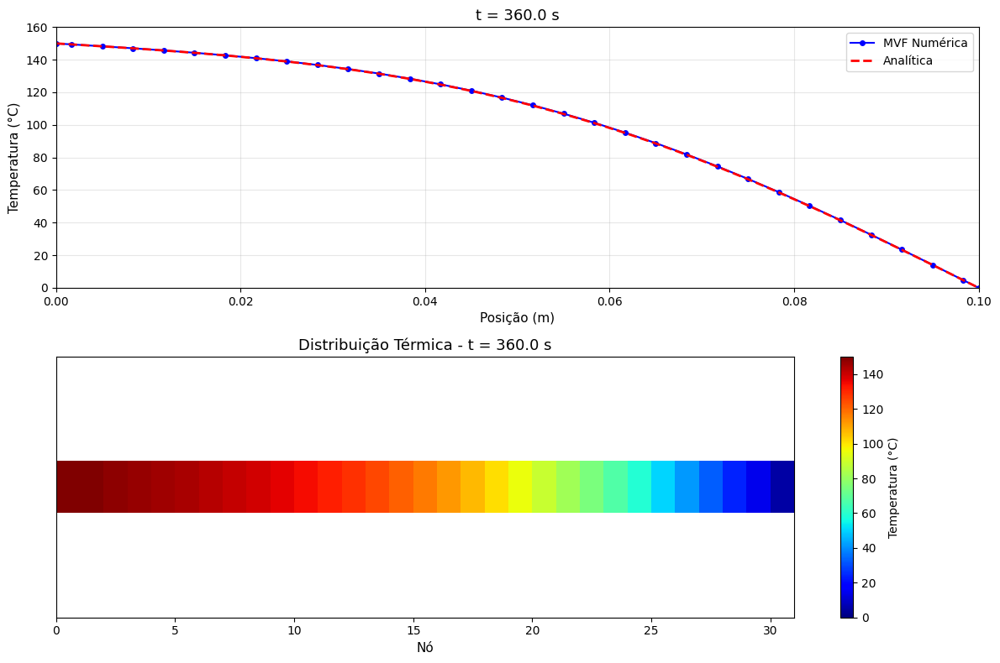

In [48]:
plt.rcParams['animation.embed_limit'] = 50

# Configuração dos plots 

fig = plt.figure(figsize=(12,8))

# Subplot 1: Gráfico de linha (numérico vs analítico)
ax1 = plt.subplot(2,1,1)
ax1.set_xlim(0, L)
ax1.set_ylim(0, 160)
ax1.set_xlabel('Posição (m)', fontsize=11)
ax1.set_ylabel('Temperatura (°C)', fontsize=11)
ax1.set_title("t = 0 s", fontsize=13)
linha_num, = ax1.plot([], [], 'o-b', label="MVF Numérica", markersize=4)
linha_ana, = ax1.plot([], [], '--r', label="Analítica", linewidth=2)
ax1.grid(True, alpha=0.3)
ax1.legend(fontsize=10)

#Subplot 2: Visualização colorida
ax2 = plt.subplot(2,1,2)
pcm = ax2.pcolormesh([T], cmap=plt.cm.jet, vmin=0, vmax=150)
plt.colorbar(pcm, ax=ax2, label='Temperatura (°C)')
ax2.set_ylim([-2, 3])
ax2.set_xlim(0, N-1)
ax2.set_xlabel("Nó", fontsize=11)
ax2.set_title("Distribuição Térmica", fontsize=13)
ax2.set_yticks([])

plt.tight_layout()

# Funções de animação

def init():
    linha_num.set_data(x, T)
    linha_ana.set_data(x, T)
    pcm.set_array([T])
    return linha_num, linha_ana, pcm

def update(frame):
    global T
    
    # Tempo atual
    t_atual = frame * dt
    
    # Evolução temporal
    if frame > 0:
        T = step_MVF(T, k, rho_cp, dx, dt, n)
    
    # Solução analítica
    T_ana = T_analitica(x, t_atual, L, 150.0, alpha)
    
    # Atualiza gráfico de linhas
    linha_num.set_data(x, T)
    linha_ana.set_data(x, T_ana)
    ax1.set_title(f"t = {t_atual:.1f} s", fontsize=13)
    
    # Atualiza visualização colorida
    pcm.set_array([T])
    ax2.set_title(f"Distribuição Térmica - t = {t_atual:.1f} s", fontsize=13)
    
    # Print das temperaturas nos nós a cada 10 segundos
    if frame == 360:
        print(f"\n{'='*60}")
        print(f"t: {t_atual:.1f} s")
        print(f"{'='*60}")
        for i in range(len(T)):
            print(f"Nó {i:2d}: {T[i]:6.2f} °C")
        print(f"{'='*60}")

    return linha_num, linha_ana, pcm



# EXECUÇÃO DA ANIMAÇÃO


anim = FuncAnimation(
    fig,
    update,
    init_func=init,
    frames=t_final + 1,
    interval=40,
    blit=True
)

HTML(anim.to_jshtml())